In [1]:
import librosa

filename = '/content/123456__alienistcog__md1trk22.wav'
x, fs = librosa.load(filename, sr=None) ## keeping the original sampling frequency
print(f"Loaded audio: {x.shape[0]} samples, Sampling rate: {fs} Hz")

Loaded audio: 2625152 samples, Sampling rate: 44100 Hz


###The Original Sound

In [15]:
from IPython.display import Audio
Audio("/content/123456__alienistcog__md1trk22.wav")

CQT shape: (84, 5128)


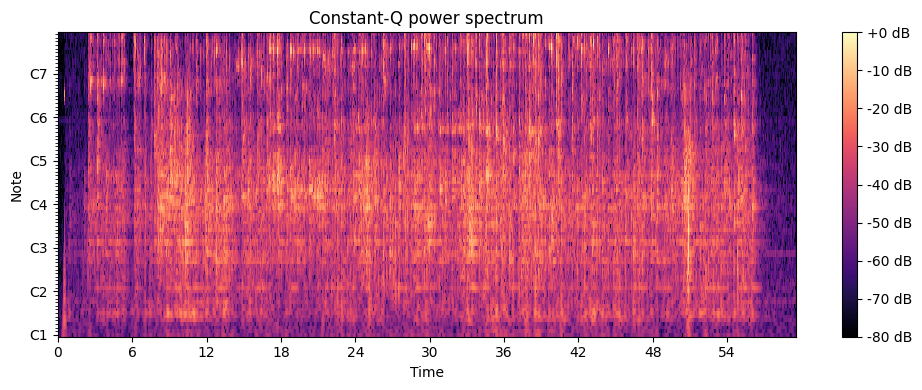

Reconstructed signal shape: (2625024,)
Reconstructed audio saved to reconstructed.wav


In [16]:
import librosa.display
import matplotlib.pyplot as plt
import soundfile as sf
import numpy as np

###### Apply Constant-Q Transform
C = librosa.cqt(x, sr=fs)
print(f"CQT shape: {C.shape}")

###### visualize the CQT
plt.figure(figsize=(10, 4))
librosa.display.specshow(librosa.amplitude_to_db(np.abs(C), ref=np.max),
                         sr=fs, x_axis='time', y_axis='cqt_note')
plt.colorbar(format='%+2.0f dB')
plt.title('Constant-Q power spectrum')
plt.tight_layout()
plt.show()

##### Invert CQT back to its time domain
x_reconstructed = librosa.icqt(C, sr=fs)

print(f"Reconstructed signal shape: {x_reconstructed.shape}")

#### save the signal in time doamin
output_filename = 'reconstructed.wav'
sf.write(output_filename, x_reconstructed, fs)
print(f"Reconstructed audio saved to {output_filename}")

###The sound from CQT

In [17]:
Audio("/content/reconstructed.wav")

In [18]:
import numpy as np
import math

def peak_Detection(mX, t):
    ### Storing spectral peaks in a magnitude spectrum above threshold t (dB).
    thresh = 10 ** (t / 20.0)
    ploc = []
    for i in range(1, len(mX)-1):
        if mX[i-1] < mX[i] and mX[i] > mX[i+1] and mX[i] > thresh:
            ploc.append(i)
    return np.array(ploc)

def peak_Interp(mX, pX, ploc):
    ### Interpolate peak locations, magnitudes, and phases.
    iploc = []
    ipmag = []
    ipphase = []
    for i in ploc:
        if i <= 0 or i >= len(mX)-1:
            continue
        alpha = mX[i-1]
        beta = mX[i]
        gamma = mX[i+1]
        p = 0.5 * (alpha - gamma) / (alpha - 2*beta + gamma)
        iploc.append(i + p)
        ipmag.append(beta - 0.25*(alpha - gamma)*p)
        ipphase.append(np.interp(i+p, np.arange(len(pX)), pX))
    return np.array(iploc), np.array(ipmag), np.array(ipphase)

def dft_Anal(x, w, N):
    ##### Compute the DFT of a frame x with window w and FFT size N.
    M = w.shape[0]
    hM1 = int(math.floor((M+1)/2))
    hM2 = int(math.floor(M/2))
    xw = x * w
    X = np.fft.fft(xw, n=N)
    absX = np.abs(X[:N//2+1])
    absX[absX < np.finfo(float).eps] = np.finfo(float).eps
    mX = 20 * np.log10(absX)
    pX = np.angle(X[:N//2+1])
    return mX, pX

def dft_Synth(mX, pX, N):
    ### Compute the inverse DFT from the stored magnitude and phase spectra.
    X = np.zeros(N, dtype=complex)
    absX = 10 ** (mX / 20.0)
    X[:len(mX)] = absX * np.exp(1j * pX)
    X[-len(mX)+1:] = absX[1:][::-1] * np.exp(-1j * pX[1:][::-1])
    x = np.fft.ifft(X).real
    return x


In [19]:
def sineModelMultiRes(x, fs, ws, Ns, t, bandEdges):
    """
    Multi-resolution sinusoidal analysis.

    Args:
        x: input sound (1D array)
        fs: sampling rate
        ws: list of 3 analysis windows (w1, w2, w3)
        Ns: list of 3 FFT sizes (N1, N2, N3)
        t: threshold in dB
        bandEdges: list of tuples [(f1_min, f1_max), (f2_min, f2_max), (f3_min, f3_max)]

    Returns:
        mX: magnitude spectrum in dB
        pX: phase spectrum
        ploc_all: list of detected peak locations for each frame
        pmag_all: list of detected peak magnitudes for each frame
        pphase_all: list of detected peak phases for each frame
    """

    M1, M2, M3 = [len(w) for w in ws] #### length of windows
    hM1, hM2, hM3 = M1 // 2, M2 // 2, M3 // 2   ### half window size needed for overlap
    N1, N2, N3 = Ns  ### list of fft sizes all of them are of different sizes, Ns is a list

    hM = max(hM1, hM2, hM3)
    M = max(M1, M2, M3)
    pin = hM
    pend = len(x) - hM

    w = ws[0]  # default window
    N = Ns[0]  # default FFT size

    mX = []
    pX = []
    ploc_all = []
    pmag_all = []
    pphase_all = []

    while pin < pend:
        # Extract 3 frames
        x1 = x[pin - hM1: pin + hM1]
        x2 = x[pin - hM2: pin + hM2]
        x3 = x[pin - hM3: pin + hM3]


        if len(x1) < M1:
            x1 = np.append(x1, np.zeros(M1 - len(x1)))
        if len(x2) < M2:
            x2 = np.append(x2, np.zeros(M2 - len(x2)))
        if len(x3) < M3:
            x3 = np.append(x3, np.zeros(M3 - len(x3)))

        # DFT analysis
        mX1, pX1 = dft_Anal(x1, ws[0], N1)
        mX2, pX2 = dft_Anal(x2, ws[1], N2)
        mX3, pX3 = dft_Anal(x3, ws[2], N3)

        # Peak detection
        ploc1 = peak_Detection(mX1, t)
        ploc2 = peak_Detection(mX2, t)
        ploc3 = peak_Detection(mX3, t)

        # Interpolation
        iploc1, ipmag1, ipphase1 = peak_Interp(mX1, pX1, ploc1)
        iploc2, ipmag2, ipphase2 = peak_Interp(mX2, pX2, ploc2)
        iploc3, ipmag3, ipphase3 = peak_Interp(mX3, pX3, ploc3)

        # Choose peaks per band
        final_ploc = []
        final_pmag = []
        final_pphase = []

        for i in range(len(iploc1)):
            freq = iploc1[i] * fs / N1
            if bandEdges[0][0] <= freq < bandEdges[0][1]:
                final_ploc.append(iploc1[i] * N / N1)
                final_pmag.append(ipmag1[i])
                final_pphase.append(ipphase1[i])

        for i in range(len(iploc2)):
            freq = iploc2[i] * fs / N2
            if bandEdges[1][0] <= freq < bandEdges[1][1]:
                final_ploc.append(iploc2[i] * N / N2)
                final_pmag.append(ipmag2[i])
                final_pphase.append(ipphase2[i])

        for i in range(len(iploc3)):
            freq = iploc3[i] * fs / N3
            if bandEdges[2][0] <= freq < bandEdges[2][1]:
                final_ploc.append(iploc3[i] * N / N3)
                final_pmag.append(ipmag3[i])
                final_pphase.append(ipphase3[i])

        ##### Store
        mX.append([mX1, mX2, mX3])  ### store merged spectrum
        pX.append([pX1, pX2, pX3]) ##### for synthesis, use stored peaks
        ploc_all.append(final_ploc)
        pmag_all.append(final_pmag)
        pphase_all.append(final_pphase)

        pin += hM

    return mX,pX,ploc_all, pmag_all, pphase_all

In [20]:
###### Hamming windows of different lengths for 3 different frequency bands
w1 = np.hamming(4096)  # for low frequencies
w2 = np.hamming(2048)  # for mid frequencies
w3 = np.hamming(1024)  # for high frequencies
ws = [w1, w2, w3]

In [21]:
bandEdges = [
    (0, 1000),     # low: handled by w1 (4096)
    (1000, 3000),  # mid: handled by w2 (2048)
    (3000, fs/2)   # high: handled by w3 (1024)
]

In [22]:
### FFT sizes for three different bands
N1 = 4096  # low-frequency band → needs higher frequency resolution
N2 = 2048  # mid-frequency band
N3 = 1024  # high-frequency band → needs better time resolution
Ns = [N1, N2, N3]


In [30]:
####threshold for peak detection, dB threshold
t = -100

In [32]:
def sineModelSynthMultiRes(ploc_all, pmag_all, pphase_all, Ns, ws, H, fs, bandEdges):
    """
    Multi-resolution sinusoidal synthesis.

    Args:
        ploc_all: list of peak locations per frame
        pmag_all: list of peak magnitudes per frame
        pphase_all: list of peak phases per frame
        Ns: list of FFT sizes used in analysis which is:: [N1, N2, N3]
        ws: list of analysis windows used in analysis which is:: [w1, w2, w3]
        H: hop size
        fs: sampling rate

    Returns:
        y: time-domain synthesized signal
    """

    # Use maximum window size for output buffer alignment
    M = max([len(w) for w in ws])
    hM = M // 2

    # Estimate output length
    numFrames = len(ploc_all)
    y_len = H * (numFrames + 1)  # Adjust length based on hop size and number of frames
    y = np.zeros(y_len)

    for i in range(numFrames):
        ploc = ploc_all[i]
        pmag = pmag_all[i]
        pphase = pphase_all[i]

        # Prepare band-wise sinusoidal frames
        frame = np.zeros(M)  # Frame will be of size M

        for k in range(len(ploc)):
            freq_bin = ploc[k]
            mag = pmag[k]
            phase = pphase[k]
            freq_Hz = freq_bin * fs / max(Ns)

            # Choosing appropriate resolution based on frequency
            if freq_Hz < bandEdges[0][1]:
                N = Ns[0]
                win = ws[0]
                M_win = len(win)
            elif freq_Hz < bandEdges[1][1]:
                N = Ns[1]
                win = ws[1]
                M_win = len(win)
            else:
                N = Ns[2]
                win = ws[2]
                M_win = len(win)

            # Generate time-domain sinusoid
            t = np.arange(M_win)
            amp = 10 ** (mag / 20.0)
            sinusoid = amp * np.cos(2 * np.pi * freq_Hz * t / fs + phase)

            # Apply window
            sinusoid *= win

            # Add to output frame with proper alignment
            start = hM - M_win // 2
            end = start + M_win
            frame[start:end] += sinusoid

        # Overlap-add
        start = i * H
        end = start + M

        if end <= len(y):
            y[start:end] += frame
        else:
            y[start:] += frame[:len(y) - start]

    return y

In [33]:
mX, pX, ploc_all, pmag_all, pphase_all = sineModelMultiRes(x, fs, ws, Ns, t, bandEdges)

hopSize = max([len(w) for w in ws]) // 4

y_reconstructed = sineModelSynthMultiRes(ploc_all, pmag_all, pphase_all, Ns, ws, hopSize, fs, bandEdges)

import soundfile as sf
sf.write("multires_reconstructed.wav", y_reconstructed, fs)

###The Sound from the modified stft

In [34]:
from IPython.display import Audio
Audio("/content/multires_reconstructed.wav")